# Echo State Network as a tunable frequency generator

This is a simplified implementation of Herbert Jaeger's task of learning a simple non-autonomous system, [a frequency generator controlled by an external signal](http://www.scholarpedia.org/article/Echo_state_network). Plots at the end.

[See the ESN implementation](https://github.com/cknd/pyESN).


In [1]:
import os 
os.chdir('..')
print("The current workding directory:", os.getcwd())

The current workding directory: /Users/sungjae/Projects/pyESN


In [1]:
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
from pyESN import ESN
from dataset.freq2wav import frequency_generator
from tqdm import tqdm

## Task

The network will learn to generate a wave signal whose frequency is determined by some slowly changing control input.

### 1) Generate some sample data:


In [2]:
randomstate = np.random.RandomState(42)

N = 15000 # signal length
min_period = 10 #[OriginalCode] 2
max_period = 18 #[OriginalCode] 10
n_changepoints = int(N/200)
frequency_control,frequency_output = frequency_generator(N,min_period,max_period,n_changepoints,randomstate)

traintest_cutoff = int(np.ceil(0.7*N))

train_ctrl, train_output = frequency_control[:traintest_cutoff],frequency_output[:traintest_cutoff]
test_ctrl, test_output  = frequency_control[traintest_cutoff:],frequency_output[traintest_cutoff:]

print("train_ctrl.shape", train_ctrl.shape)
print("train_output.shape", train_output.shape)
print("test_ctrl.shape", test_ctrl.shape)
print("test_output.shape", test_output.shape)

train_ctrl.shape (10500, 2)
train_output.shape (10500, 1)
test_ctrl.shape (4500, 2)
test_output.shape (4500, 1)


In [3]:
randomstate = np.random.RandomState(42)

N = 15000 # signal length
min_period = 10 #[OriginalCode] 2
max_period = 18 #[OriginalCode] 10
n_changepoints = 0
easy_frequency_control, easy_frequency_output = frequency_generator(N,min_period,max_period,n_changepoints,randomstate)

traintest_cutoff = int(np.ceil(0.7*N))

easy_train_ctrl, easy_train_output = easy_frequency_control[:traintest_cutoff],frequency_output[:traintest_cutoff]
easy_test_ctrl, easy_test_output  = easy_frequency_control[traintest_cutoff:],frequency_output[traintest_cutoff:]

print("easy_train_ctrl.shape", easy_train_ctrl.shape)
print("easy_train_output.shape", easy_train_output.shape)
print("easy_test_ctrl.shape", easy_test_ctrl.shape)
print("easy_test_output.shape", easy_test_output.shape)

easy_train_ctrl.shape (10500, 2)
easy_train_output.shape (10500, 1)
easy_test_ctrl.shape (4500, 2)
easy_test_output.shape (4500, 1)


In [29]:
easy_test_ctrl

array([[1.        , 0.62545988],
       [1.        , 0.62545988],
       [1.        , 0.62545988],
       ...,
       [1.        , 0.62545988],
       [1.        , 0.62545988],
       [1.        , 0.62545988]])

In [36]:
randomstate = np.random.RandomState(73)

N = 15000 # signal length
min_period = 10 #[OriginalCode] 2
max_period = 18 #[OriginalCode] 10
n_changepoints = 0
easy2_frequency_control, easy2_frequency_output = frequency_generator(N,min_period,max_period,n_changepoints,randomstate)

traintest_cutoff = int(np.ceil(0.7*N))

easy2_train_ctrl, easy2_train_output = easy2_frequency_control[:traintest_cutoff],frequency_output[:traintest_cutoff]
easy2_test_ctrl, easy2_test_output  = easy2_frequency_control[traintest_cutoff:],frequency_output[traintest_cutoff:]

print("easy2_train_ctrl.shape", easy2_train_ctrl.shape)
print("easy2_train_output.shape", easy2_train_output.shape)
print("easy2_test_ctrl.shape", easy2_test_ctrl.shape)
print("easy2_test_output.shape", easy2_test_output.shape)

easy2_train_ctrl.shape (10500, 2)
easy2_train_output.shape (10500, 1)
easy2_test_ctrl.shape (4500, 2)
easy2_test_output.shape (4500, 1)


In [37]:
easy2_test_ctrl

array([[1.        , 0.35731008],
       [1.        , 0.35731008],
       [1.        , 0.35731008],
       ...,
       [1.        , 0.35731008],
       [1.        , 0.35731008],
       [1.        , 0.35731008]])

### 2) Instantiate, train & test the network
Parameters are mostly the same as in Herbert Jaeger's original Matlab code. 

#### 2.1. Reservoir size

In [4]:
init_params = {
    'n_inputs' : 2,
    'n_outputs' : 1,
    'n_reservoir' : 200,
    'spectral_radius' : 0.25,
    'sparsity' : 0.95,
    'noise' : 0.001,
    'input_shift' : [0,0],
    'input_scaling' : [0.01, 3],
    'teacher_scaling' : 1.12,
    'teacher_shift' : -0.7,
    'out_activation' : np.tanh,
    'inverse_out_activation' : np.arctanh,
    'random_state' : randomstate,
    'silent' : True,
    'concat_input2state' : False
}
params = init_params.copy()

In [5]:
def init_ESN(params):
    esn = ESN(n_inputs = params['n_inputs'],
              n_outputs = params['n_outputs'],
              n_reservoir = params['n_reservoir'],
              spectral_radius = params['spectral_radius'],
              sparsity = params['sparsity'],
              noise = params['noise'],
              input_shift = params['input_shift'],
              input_scaling = params['input_scaling'],
              teacher_scaling = params['teacher_scaling'],
              teacher_shift = params['teacher_shift'],
              out_activation = params['out_activation'],
              inverse_out_activation = params['inverse_out_activation'],
              random_state = params['random_state'],
              silent = params['silent'],
              concat_input2state = params['concat_input2state'])
    return esn

In [6]:
def run_ESN(params, train_ctrl, train_output, test_ctrl, test_output):
    esn = ESN(n_inputs = params['n_inputs'],
              n_outputs = params['n_outputs'],
              n_reservoir = params['n_reservoir'],
              spectral_radius = params['spectral_radius'],
              sparsity = params['sparsity'],
              noise = params['noise'],
              input_shift = params['input_shift'],
              input_scaling = params['input_scaling'],
              teacher_scaling = params['teacher_scaling'],
              teacher_shift = params['teacher_shift'],
              out_activation = params['out_activation'],
              inverse_out_activation = params['inverse_out_activation'],
              random_state = params['random_state'],
              silent = params['silent'],
              concat_input2state = params['concat_input2state'])

    pred_train, train_error = esn.fit(train_ctrl,train_output)

    pred_test = esn.predict(test_ctrl)
    test_error = np.sqrt(np.mean((pred_test - test_output)**2))
    return pred_train, train_error, pred_test, test_error

In [39]:
reservoir_sizes = list()
train_errors = list()
test_errors = list()
for reservoir_size in tqdm(range(12,1001,12)):
    params['n_reservoir'] = reservoir_size
    pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    reservoir_sizes.append(reservoir_size)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 83/83 [03:31<00:00,  2.55s/it]


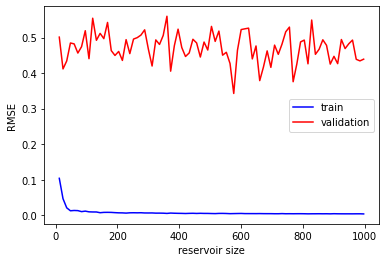

In [41]:
plt.plot(reservoir_sizes, train_errors, color='blue', label='train')
plt.plot(reservoir_sizes, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('reservoir size')
plt.ylabel('RMSE')

plt.show()

In [70]:
reservoir_sizes = list()
train_errors = list()
test_errors = list()
for reservoir_size in tqdm(range(12,101,2)):
    params['n_reservoir'] = reservoir_size
    pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    reservoir_sizes.append(reservoir_size)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 45/45 [00:11<00:00,  3.97it/s]


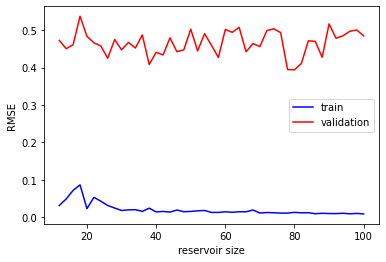

In [71]:
plt.plot(reservoir_sizes, train_errors, color='blue', label='train')
plt.plot(reservoir_sizes, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('reservoir size')
plt.ylabel('RMSE')

plt.show()

In [90]:
# Change the random seed
params['random_state'] = np.random.RandomState(54)

In [92]:
reservoir_sizes = list()
train_errors = list()
test_errors = list()
for reservoir_size in tqdm(range(12,101,2)):
    params['n_reservoir'] = reservoir_size
    pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    reservoir_sizes.append(reservoir_size)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 45/45 [00:11<00:00,  4.00it/s]


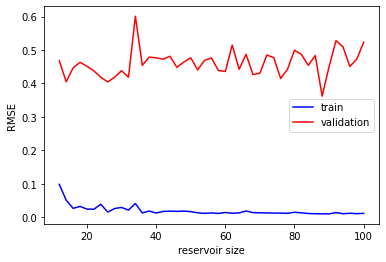

In [93]:
plt.plot(reservoir_sizes, train_errors, color='blue', label='train')
plt.plot(reservoir_sizes, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('reservoir size')
plt.ylabel('RMSE')

plt.show()

In [94]:
# Change the random seed
params['random_state'] = np.random.RandomState(67)

In [98]:
reservoir_sizes = list()
train_errors = list()
test_errors = list()
for reservoir_size in tqdm(range(12,101,2)):
    params['n_reservoir'] = reservoir_size
    pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    reservoir_sizes.append(reservoir_size)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 45/45 [00:11<00:00,  3.98it/s]


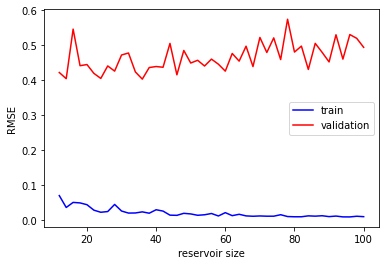

In [99]:
plt.plot(reservoir_sizes, train_errors, color='blue', label='train')
plt.plot(reservoir_sizes, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('reservoir size')
plt.ylabel('RMSE')

plt.show()

#### 2.2. Sparsity

In [77]:
params = init_params.copy()

In [89]:
sparsity_list = list()
train_errors = list()
test_errors = list()
for sparsity in tqdm(np.arange(0,1.0,0.05)):
    params['sparsity'] = sparsity
    pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    sparsity_list.append(sparsity)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 20/20 [00:16<00:00,  1.24it/s]


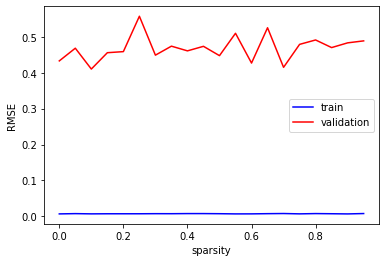

In [86]:
plt.plot(sparsity_list, train_errors, color='blue', label='train')
plt.plot(sparsity_list, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('sparsity')
plt.ylabel('RMSE')

plt.show()

#### 2.3. Input scaling

In [102]:
params = init_params.copy()

In [110]:
input_scales = list()
train_errors = list()
test_errors = list()
for input_scale in tqdm(np.arange(0.01,5,0.01)):
    params['input_scaling'] = [0.01, input_scale]
    pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    input_scales.append(input_scale)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 499/499 [06:43<00:00,  1.24it/s]


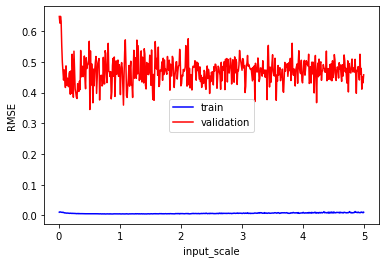

In [112]:
plt.plot(input_scales, train_errors, color='blue', label='train')
plt.plot(input_scales, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('input_scale')
plt.ylabel('RMSE')

plt.show()

In [113]:
input_scales = list()
train_errors = list()
test_errors = list()
for input_scale in tqdm(np.arange(0.01,5,0.01)):
    params['input_scaling'] = [0.00, input_scale]
    pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    input_scales.append(input_scale)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 499/499 [06:52<00:00,  1.21it/s]


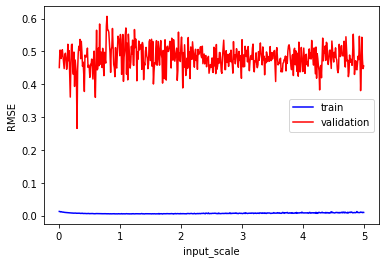

In [116]:
plt.plot(input_scales, train_errors, color='blue', label='train')
plt.plot(input_scales, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('input_scale')
plt.ylabel('RMSE')

plt.show()

In [115]:
params = init_params.copy()

In [117]:
input_scales = list()
train_errors = list()
test_errors = list()
for input_scale in tqdm(np.arange(0.01,5,0.01)):
    pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    input_scales.append(input_scale)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 499/499 [06:43<00:00,  1.24it/s]


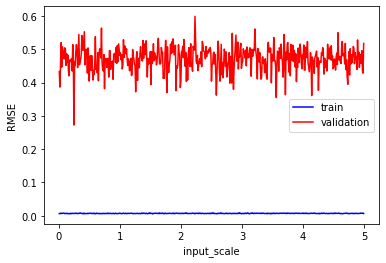

In [118]:
plt.plot(input_scales, train_errors, color='blue', label='train')
plt.plot(input_scales, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('input_scale')
plt.ylabel('RMSE')

plt.show()

#### 2.4. Spectral radius

In [60]:
params = init_params.copy()

In [61]:
spectral_radius_list = list()
train_errors = list()
test_errors = list()
for spectral_radius in tqdm(np.arange(0.01,2,0.01)):
    params['spectral_radius'] = spectral_radius
    pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    spectral_radius_list.append(spectral_radius)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 199/199 [02:51<00:00,  1.16it/s]


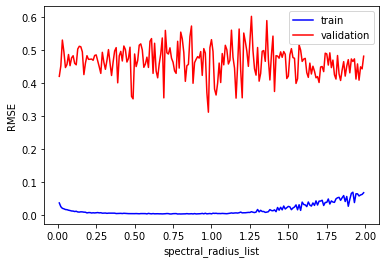

In [62]:
plt.plot(spectral_radius_list, train_errors, color='blue', label='train')
plt.plot(spectral_radius_list, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('spectral_radius_list')
plt.ylabel('RMSE')

plt.show()

In [63]:
# Try different random seed
params = init_params.copy()
params['random_state'] = np.random.RandomState(73)

In [64]:
spectral_radius_list = list()
train_errors = list()
test_errors = list()
for spectral_radius in tqdm(np.arange(0.01,2,0.01)):
    params['spectral_radius'] = spectral_radius
    pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    spectral_radius_list.append(spectral_radius)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 199/199 [03:12<00:00,  1.03it/s]


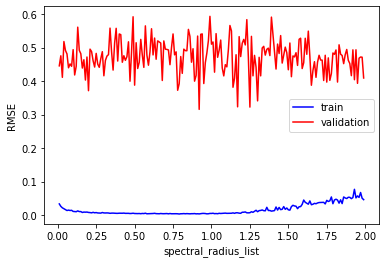

In [66]:
plt.plot(spectral_radius_list, train_errors, color='blue', label='train')
plt.plot(spectral_radius_list, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('spectral_radius_list')
plt.ylabel('RMSE')

plt.show()

#### 3) Plots
First, a look at the control signal, the target signal and the output of the model both during training and during testing.

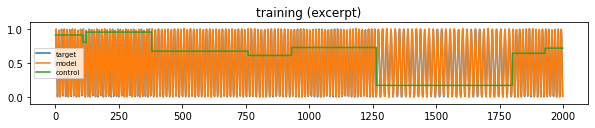

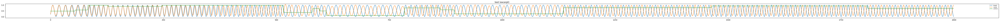

In [123]:
window_tr = range(int(len(train_output)/4),int(len(train_output)/4+2000))
plt.figure(figsize=(10,1.5))
plt.plot(train_output[window_tr],label='target')
plt.plot(pred_train[window_tr],label='model')
plt.plot(train_ctrl[window_tr,1],label='control')
plt.legend(fontsize='x-small')
plt.title('training (excerpt)')
plt.ylim([-0.1,1.1])

window_test = range(2000)
plt.figure(figsize=(100,1.5))
plt.plot(test_output[window_test],label='target')
plt.plot(pred_test[window_test],label='model')
plt.plot(test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.ylim([-0.1,1.1]);

train_error
0.007066232248958046
test_error
0.48248785474798517


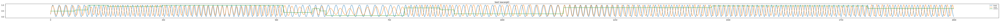

In [149]:
params = init_params.copy()
pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
print("train_error")
print(train_error)
print("test_error")
print(test_error)

window_test = range(2000)
plt.figure(figsize=(100,1.5))
plt.plot(test_output[window_test],label='target')
plt.plot(pred_test[window_test],label='model')
plt.plot(test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.ylim([-0.1,1.1]);

train_error
0.007699193450234425
test_error
0.47643189843625744


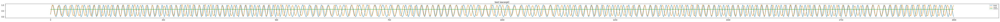

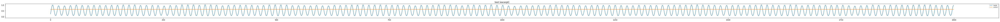

In [153]:
params = init_params.copy()
pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, easy_test_ctrl, easy_test_output)
print("train_error")
print(train_error)
print("test_error")
print(test_error)

window_test = range(2000)
plt.figure(figsize=(100,1.5))
plt.plot(easy_test_output[window_test],label='target')
plt.plot(pred_test[window_test],label='model')
plt.plot(easy_test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.ylim([-0.1,1.1]);
plt.show()

window_test = range(2000)
plt.figure(figsize=(100,1.5))
plt.plot(pred_test[window_test],label='model')
plt.plot(easy_test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.ylim([-0.1,1.1]);
plt.show()

train_error
0.023513350661792037
test_error
0.474991685254254


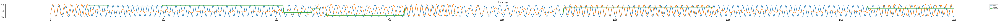

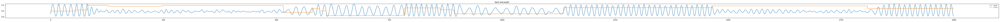

In [45]:
params = init_params.copy()
params['n_reservoir'] = 32
esn = init_ESN(params)
pred_train, train_error = esn.fit(train_ctrl,train_output)
pred_test = esn.predict(test_ctrl)
test_error = np.sqrt(np.mean((pred_test - test_output)**2))
print("train_error")
print(train_error)
print("test_error")
print(test_error)

window_test = range(2000)
plt.figure(figsize=(100,1.5))
plt.plot(test_output[window_test],label='target')
plt.plot(pred_test[window_test],label='model')
plt.plot(test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.ylim([-0.1,1.1]);
plt.show()

window_test = range(2000)
plt.figure(figsize=(100,1.5))
plt.plot(pred_test[window_test],label='model')
plt.plot(test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.ylim([-0.1,1.1]);
plt.show()

test_error
0.44989226462597454


<Figure size 432x288 with 0 Axes>

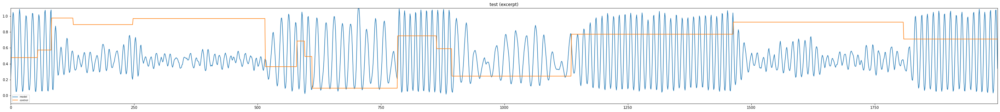

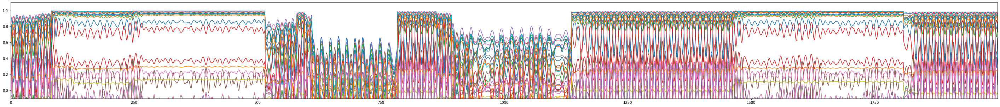

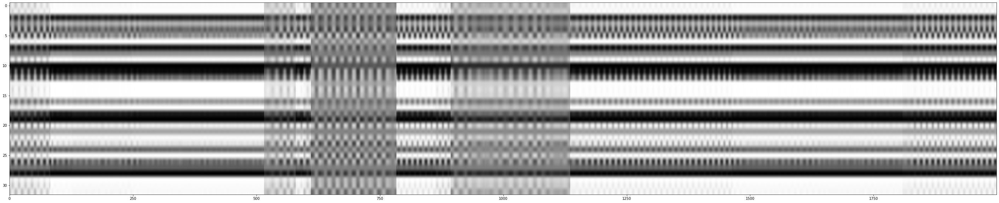

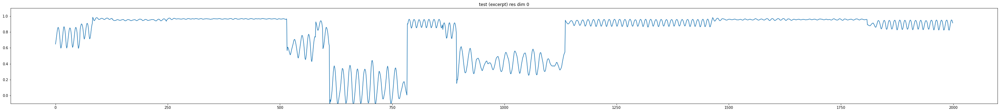

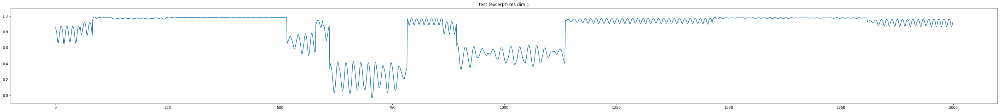

...

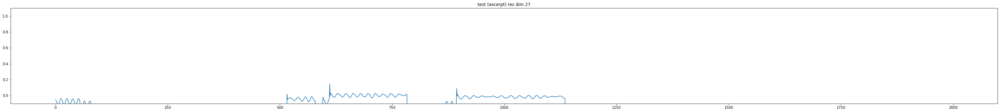

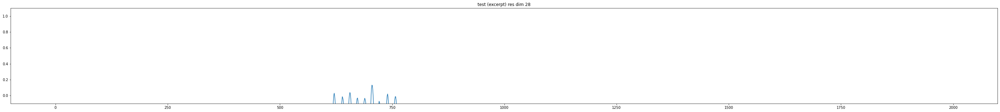

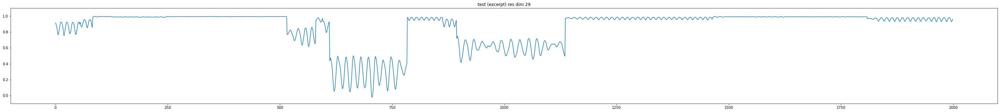

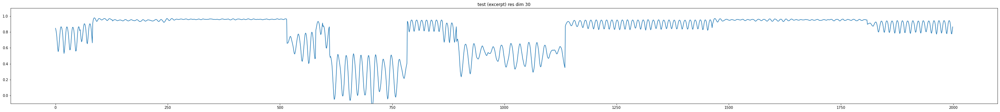

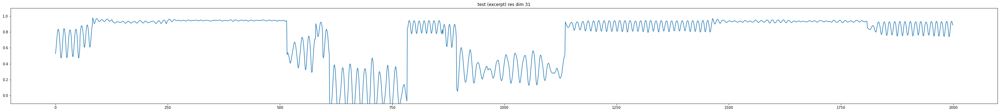

In [87]:
pred_test = esn.predict(test_ctrl)
test_error = np.sqrt(np.mean((pred_test - test_output)**2))
print("test_error")
print(test_error)
pred_states = esn.get_pred_states()

window_test = range(2000)
plt.tight_layout()
plt.figure(figsize=(50,5))
plt.plot(pred_test[window_test],label='model')
plt.plot(test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1])
plt.show()

window_test = range(2000)
plt.figure(figsize=(50,5))
for i in range(pred_states.shape[1]):
    plt.plot(pred_states[window_test,i],label='{}-dim'.format(i))
#plt.legend(fontsize='x-small')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1]);
plt.show()

plt.figure(figsize=(50,10))
plt.imshow(pred_states[window_test,:].T, cmap='gray', aspect='auto')
plt.xlim([window_test[0],window_test[-1]])
plt.show()

window_test = range(2000)
for i in range(pred_states.shape[1]):
    plt.figure(figsize=(50,5))
    plt.plot(pred_states[window_test,i],label='model')
    #plt.legend(fontsize='x-small')
    plt.title('test (excerpt) res dim {}'.format(i))
    plt.ylim([-0.1,1.1]);
    plt.show()

test_error
0.539512692957131


<Figure size 432x288 with 0 Axes>

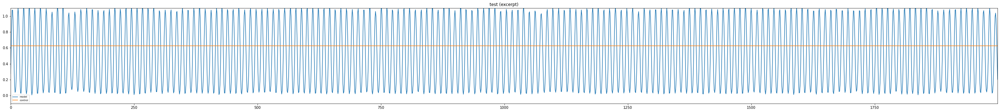

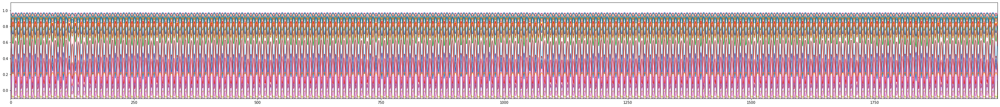

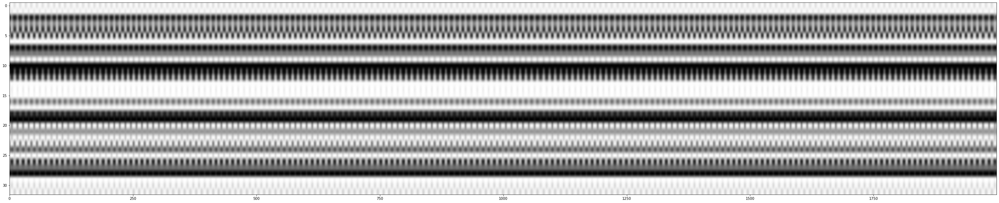

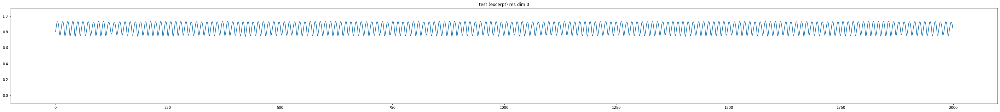

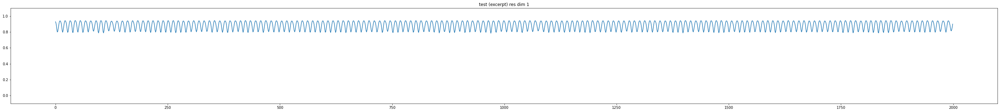

...

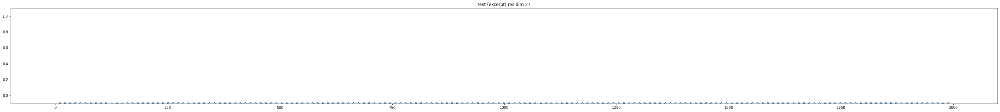

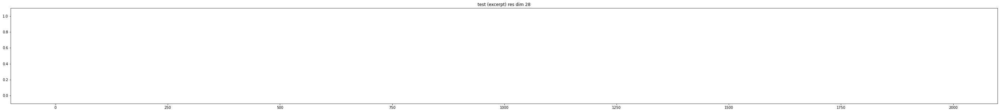

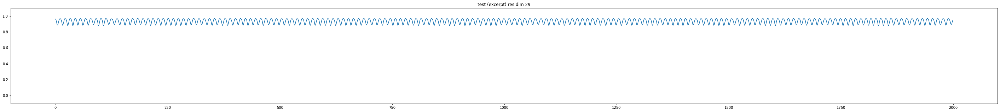

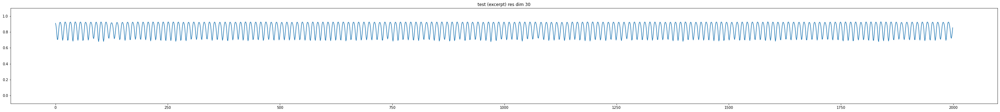

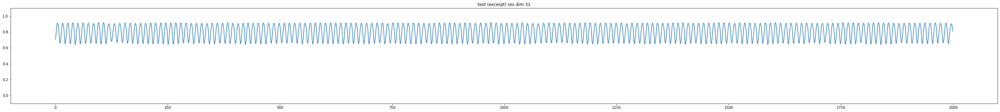

In [88]:
tmp_test_output = test_output.copy()
tmp_test_ctrl = test_ctrl.copy()
test_output = easy_test_output
test_ctrl = easy_test_ctrl

pred_test = esn.predict(test_ctrl)
test_error = np.sqrt(np.mean((pred_test - test_output)**2))
print("test_error")
print(test_error)
pred_states = esn.get_pred_states()

window_test = range(2000)
plt.tight_layout()
plt.figure(figsize=(50,5))
plt.plot(pred_test[window_test],label='model')
plt.plot(test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1])
plt.show()

window_test = range(2000)
plt.figure(figsize=(50,5))
for i in range(pred_states.shape[1]):
    plt.plot(pred_states[window_test,i],label='{}-dim'.format(i))
#plt.legend(fontsize='x-small')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1]);
plt.show()

plt.figure(figsize=(50,10))
plt.imshow(pred_states[window_test,:].T, cmap='gray', aspect='auto')
plt.xlim([window_test[0],window_test[-1]])
plt.show()

window_test = range(2000)
for i in range(pred_states.shape[1]):
    plt.figure(figsize=(50,5))
    plt.plot(pred_states[window_test,i],label='model')
    #plt.legend(fontsize='x-small')
    plt.title('test (excerpt) res dim {}'.format(i))
    plt.ylim([-0.1,1.1]);
    plt.show()

test_output = tmp_test_output
test_ctrl = tmp_test_ctrl

test_error
0.4861886981719861


<Figure size 432x288 with 0 Axes>

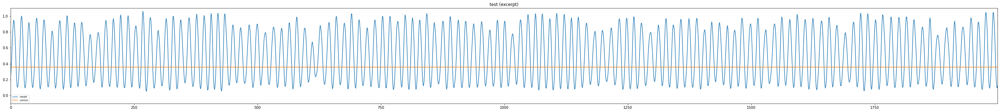

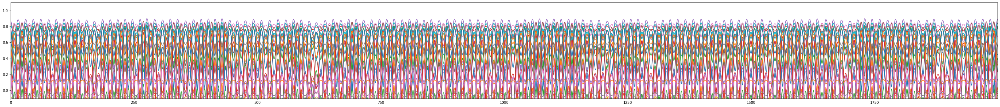

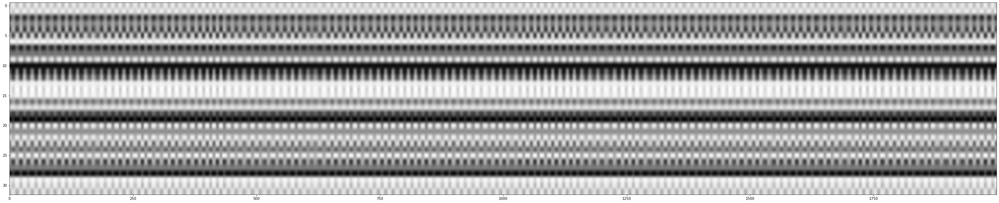

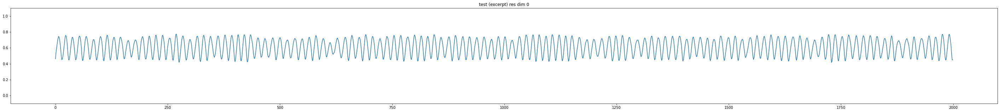

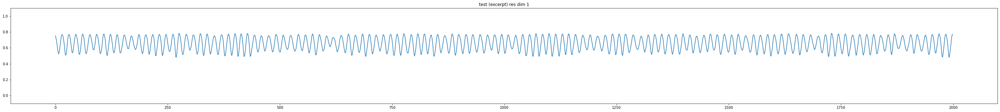

...

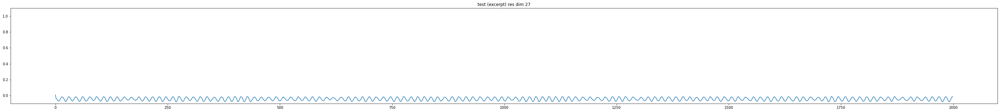

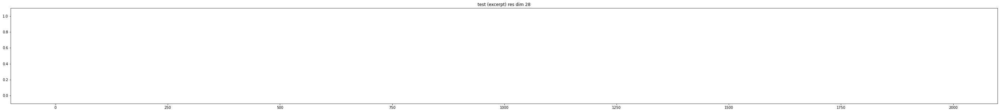

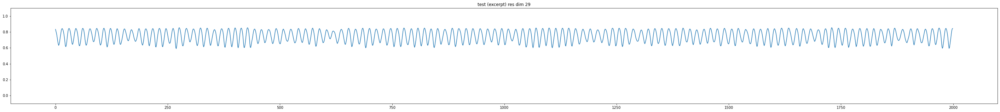

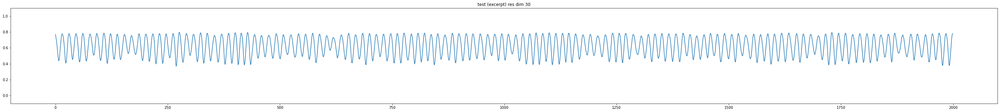

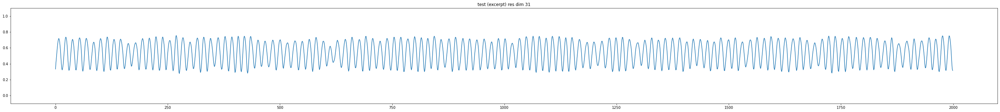

In [89]:
tmp_test_output = test_output.copy()
tmp_test_ctrl = test_ctrl.copy()
test_output = easy2_test_output
test_ctrl = easy2_test_ctrl

pred_test = esn.predict(test_ctrl)
test_error = np.sqrt(np.mean((pred_test - test_output)**2))
print("test_error")
print(test_error)
pred_states = esn.get_pred_states()

window_test = range(2000)
plt.tight_layout()
plt.figure(figsize=(50,5))
plt.plot(pred_test[window_test],label='model')
plt.plot(test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1])
plt.show()

window_test = range(2000)
plt.figure(figsize=(50,5))
for i in range(pred_states.shape[1]):
    plt.plot(pred_states[window_test,i],label='{}-dim'.format(i))
#plt.legend(fontsize='x-small')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1]);
plt.show()

plt.figure(figsize=(50,10))
plt.imshow(pred_states[window_test,:].T, cmap='gray', aspect='auto')
plt.xlim([window_test[0],window_test[-1]])
plt.show()

window_test = range(2000)
for i in range(pred_states.shape[1]):
    plt.figure(figsize=(50,5))
    plt.plot(pred_states[window_test,i],label='model')
    #plt.legend(fontsize='x-small')
    plt.title('test (excerpt) res dim {}'.format(i))
    plt.ylim([-0.1,1.1]);
    plt.show()

test_output = tmp_test_output
test_ctrl = tmp_test_ctrl

What we see is that we can't see much, except that the amplitude is systematically too small (any ideas why that is?).

So let's look at a few spectrograms to see how the frequency spectrum of these signals changes over time.

Text(0.5, 1.0, 'test: model')

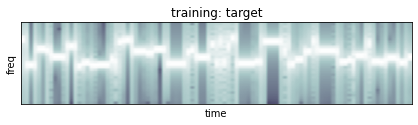

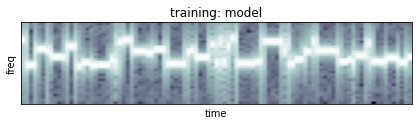

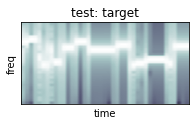

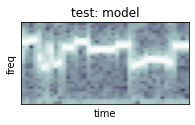

In [5]:
def draw_spectogram(data):
    plt.specgram(data,Fs=4,NFFT=256,noverlap=150,cmap=plt.cm.bone,detrend=lambda x:(x-0.5))
    plt.gca().autoscale('x')
    plt.ylim([0,0.5])
    plt.ylabel("freq")
    plt.yticks([])
    plt.xlabel("time")
    plt.xticks([])

plt.figure(figsize=(7,1.5))
draw_spectogram(train_output.flatten())
plt.title("training: target")
plt.figure(figsize=(7,1.5))
draw_spectogram(pred_train.flatten())
plt.title("training: model")

plt.figure(figsize=(3,1.5))
draw_spectogram(test_output.flatten())
plt.title("test: target")
plt.figure(figsize=(3,1.5))
draw_spectogram(pred_test.flatten())
plt.title("test: model")

It's a frequency generator!